In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
import folium
from wordcloud import WordCloud

In [2]:
df = pd.read_csv("cargurus.csv")
df2 = pd.read_json("modelcode.json")

In [3]:
df.head()

,_id,text,year,model,zipcode,price,mileage
0,5f9703ba5011a7941e545b78,"Used 2021 BMW 8 Series for sale - $88,999 - 2,...",2021,c30831,12468,"88,999","2,000"
1,5f9703bb5011a7941e545b79,Used 2007 Mercedes-Benz R-Class R 350 4MATIC f...,2007,c6253,12928,"5,555","133,137"
2,5f9703bb5011a7941e545b7a,Used 2007 Mercedes-Benz R-Class R 320 CDI 4MAT...,2007,c6253,12928,"7,999","117,210"
3,5f9703bb5011a7941e545b7b,Used 2007 Mercedes-Benz R-Class R 350 4MATIC f...,2007,c6253,12928,"7,995","98,477"
4,5f9703bb5011a7941e545b7c,Used 2007 Mercedes-Benz R-Class R 350 4MATIC f...,2007,c6253,12928,"7,900","114,476"


In [4]:
df2.head()

,_id,year,make,model,code
0,{'$oid': '5f96f08c8ba96e2546164302'},2020,Acura,MDX,c29535
1,{'$oid': '5f96f08e8ba96e2546164303'},2019,Acura,MDX,c27735
2,{'$oid': '5f96f08e8ba96e2546164304'},2018,Acura,MDX,c27203
3,{'$oid': '5f96f08f8ba96e2546164305'},2017,Acura,MDX,c25860
4,{'$oid': '5f96f08f8ba96e2546164306'},2016,Acura,MDX,c24806


In [5]:
df['price'] = df['price'].str.replace(',', '')
df['mileage'] = df['mileage'].str.replace(',', '')
df['mileage'] = df['mileage'].astype(int)

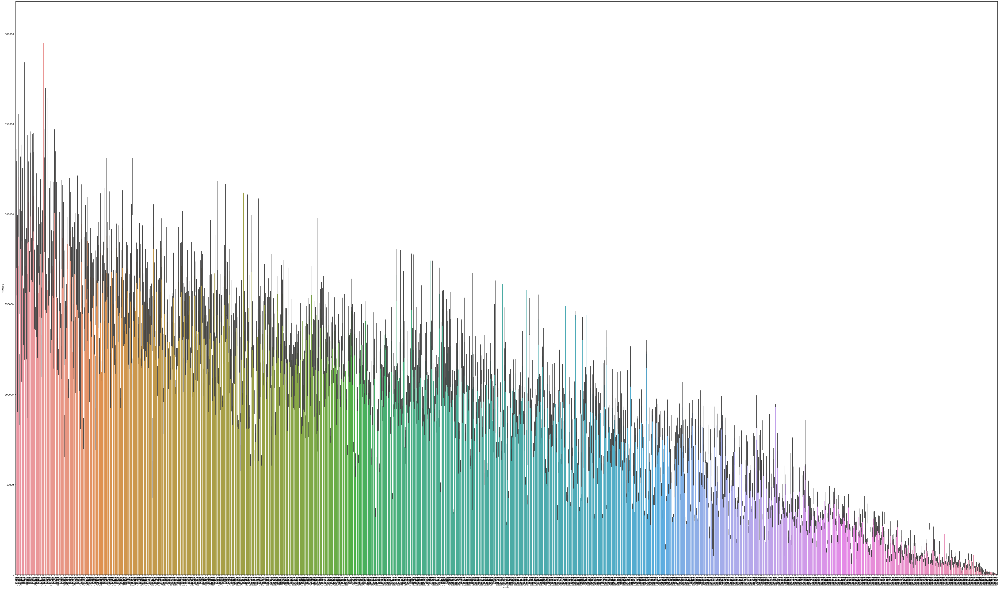

In [6]:
df=df.sort_values(by=['mileage'],ascending=False)
plt.figure(figsize=(75,45))
sns.barplot(x=df['model'], y=df['mileage'])
plt.xticks(rotation= 90)
plt.xlabel('model')
plt.ylabel('mileage')
plt.show()

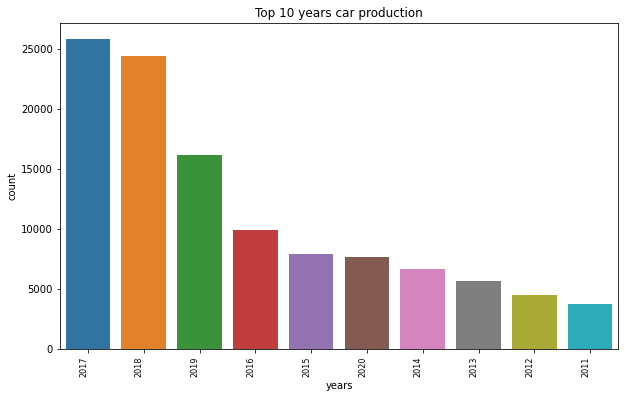

In [7]:
plt.figure(figsize=(10,6))
years = df['year'].value_counts().iloc[:10]
years = pd.DataFrame({'years' : years.index.astype(int), 'count' : years.values.astype(int)})
ax = sns.barplot(x='years', y='count', data=years, order = years['years']);
ax.set_xticklabels(ax.get_xticklabels(), rotation=90, ha="right",fontsize=8);
plt.title("Top 10 years car production");# fig = plt.figure(figsize = (20,20))

In [8]:
import sweetviz

In [9]:
report = sweetviz.analyze([df,'df'],target_feat='mileage')
report.show_html('report.html')


Report report.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


In [10]:
from uszipcode import SearchEngine, SimpleZipcode, Zipcode
search = SearchEngine()
def zco(x):
    city = search.by_zipcode(x).major_city
    return city if city else 'None'
df['City'] = df['zipcode'].fillna(0).astype(int).apply(zco)

In [11]:
df.head()

,_id,text,year,model,zipcode,price,mileage,City
93887,5fa0c749c2b4a27b12cada3e,"Used 2000 Toyota Celica GT for sale - $3,900 -...",2000,c4008,13669,3900,377214,Ogdensburg
93519,5fa0c731c2b4a27b12cad775,Used 2003 Toyota Tacoma Prerunner Crew Cab SB ...,2003,c3589,13813,4000,368290,Nineveh
19212,5f9737b14407323bdb81dd1b,Used 2002 Subaru Impreza WRX Wagon for sale - ...,2002,c23983,12010,2999,368000,Amsterdam
93226,5fa0c71ec2b4a27b12cad506,Used 2000 Toyota 4Runner SR5 4WD for sale - $2...,2000,c4004,13052,2995,359986,De Ruyter
18686,5f9737344407323bdb81db19,"Used 2001 Honda Odyssey EX FWD for sale - $1,5...",2001,c2114,12911,1500,357549,Keeseville


In [12]:
search = SearchEngine()
def zco(x):
    city = search.by_zipcode(x).lat
    return city if city else 0
df['lat'] = df['zipcode'].fillna(0).astype(int).apply(zco)

In [13]:
search = SearchEngine()
def zco(x):
    city = search.by_zipcode(x).lng
    return city if city else 0
df['lng'] = df['zipcode'].fillna(0).astype(int).apply(zco)

In [14]:
df.head()

,_id,text,year,model,zipcode,price,mileage,City,lat,lng
93887,5fa0c749c2b4a27b12cada3e,"Used 2000 Toyota Celica GT for sale - $3,900 -...",2000,c4008,13669,3900,377214,Ogdensburg,44.70,-75.50
93519,5fa0c731c2b4a27b12cad775,Used 2003 Toyota Tacoma Prerunner Crew Cab SB ...,2003,c3589,13813,4000,368290,Nineveh,42.17,-75.53
19212,5f9737b14407323bdb81dd1b,Used 2002 Subaru Impreza WRX Wagon for sale - ...,2002,c23983,12010,2999,368000,Amsterdam,42.90,-74.20
93226,5fa0c71ec2b4a27b12cad506,Used 2000 Toyota 4Runner SR5 4WD for sale - $2...,2000,c4004,13052,2995,359986,De Ruyter,42.70,-75.90
18686,5f9737344407323bdb81db19,"Used 2001 Honda Odyssey EX FWD for sale - $1,5...",2001,c2114,12911,1500,357549,Keeseville,44.52,-73.47


In [15]:
df.to_csv('out.csv')

In [16]:
df2.to_csv('code.csv')

In [17]:
import plotly.graph_objects as go

In [18]:
df['lng'] = df['lng'].fillna(0).astype(float)

In [19]:
import plotly.express as px

fig = px.scatter_mapbox(df, lat="lat", lon="lng", hover_name="City", hover_data=["price", "mileage"],
                        color_discrete_sequence=["fuchsia"], zoom=3, height=300)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [20]:
report = sweetviz.analyze([df,'df'],target_feat='mileage')
report.show_html('report.html')


Report report.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.


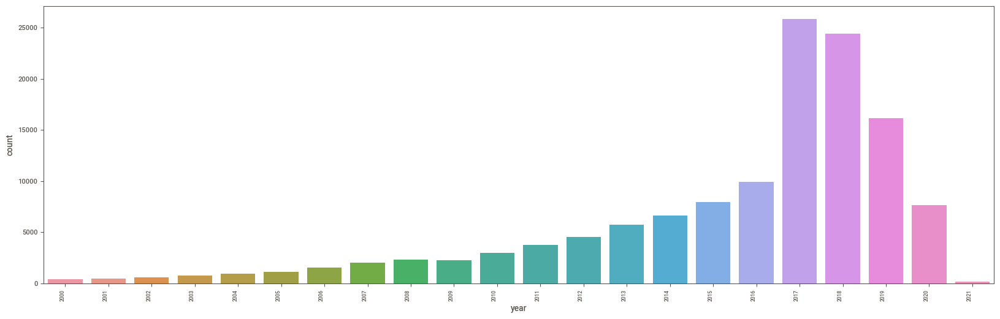

In [21]:
plt.figure(figsize=(20,6))
ax = sns.countplot(x='year',data=df);
ax.set_xticklabels(ax.get_xticklabels(), rotation=90, ha="right",fontsize=6);

In [22]:
df = df.drop(["text"],axis=1)

In [23]:
df = df.drop(["City"], axis = 1)

In [24]:
df = df.drop(["_id"], axis = 1)

In [25]:
df['model'] = df['model'].str.replace('c', '')

In [26]:
from sklearn import datasets, linear_model
from sklearn.model_selection import train_test_split

In [27]:
y= df.price
X= df.drop('price',axis=1)

In [28]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [29]:
print (X_train.shape, y_train.shape)
print (X_test.shape, y_test.shape)

(102537, 6) (102537,)
(25635, 6) (25635,)


In [30]:
# Create a dataframe to store rmse
accuracy_df = pd.DataFrame(columns=('r2', 'rmse'))

In [32]:
from sklearn.ensemble import RandomForestRegressor
from sklearn import metrics
from sklearn.metrics import mean_squared_error as MSE

regressor = RandomForestRegressor(n_estimators=20, random_state=0)
regressor.fit(X_train, y_train)
y_pred = regressor.predict(X_test)
# Metrics
r2 = round(metrics.r2_score(y_test, y_pred),2)
rmse = round(np.sqrt(metrics.mean_squared_error(y_test, y_pred)),2)
accuracy_df = accuracy_df.append(pd.DataFrame({'r2':[r2],'rmse':[rmse]}, index = ['Random Forest Regressor']))

In [33]:
from sklearn import metrics
from sklearn.metrics import mean_squared_error as MSE

In [34]:
from sklearn.linear_model import LinearRegression, SGDRegressor, RidgeCV
from sklearn.svm import SVR, LinearSVR
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, ExtraTreesRegressor 
from sklearn.neural_network import MLPRegressor
from sklearn.tree import DecisionTreeRegressor

In [35]:
# Linera Regression
linreg = LinearRegression()
linreg.fit(X,y)

# Metrics
r2 = round(metrics.r2_score(y_test, y_pred),2)
rmse = round(np.sqrt(metrics.mean_squared_error(y_test, y_pred)),2)
accuracy_df = accuracy_df.append(pd.DataFrame({'r2':[r2],'rmse':[rmse]}, index = ['Linear Regression']))

In [36]:
# Support Vector Machines
svr = SVR()
svr.fit(X, y)

# Metrics
r2 = round(metrics.r2_score(y_test, y_pred),2)
rmse = round(np.sqrt(metrics.mean_squared_error(y_test, y_pred)),2)
accuracy_df = accuracy_df.append(pd.DataFrame({'r2':[r2],'rmse':[rmse]}, index = ['SVR']))

In [37]:
# Linear SVR
linear_svr = LinearSVR()
linear_svr.fit(X, y)
# Metrics
r2 = round(metrics.r2_score(y_test, y_pred),2)
rmse = round(np.sqrt(metrics.mean_squared_error(y_test, y_pred)),2)
accuracy_df = accuracy_df.append(pd.DataFrame({'r2':[r2],'rmse':[rmse]}, index = ['Linear SVR']))

C:\Users\newbee\anaconda3\lib\site-packages\sklearn\svm\_base.py:976: ConvergenceWarning:

Liblinear failed to converge, increase the number of iterations.



In [38]:
# Decision Tree
from sklearn.tree import DecisionTreeRegressor
import matplotlib.pyplot as plt
from sklearn import metrics
import math
from sklearn.metrics import mean_squared_error as MSE

# Fit
model = DecisionTreeRegressor()
model.fit(X_train, y_train)

# Predict
y_pred = model.predict(X_test)

# Metrics
r2 = round(metrics.r2_score(y_test, y_pred),2)
rmse = round(np.sqrt(metrics.mean_squared_error(y_test, y_pred)),2)
accuracy_df = accuracy_df.append(pd.DataFrame({'r2':[r2],'rmse':[rmse]}, index = ['Decision Tree Baseline']))

In [39]:
accuracy_df

,r2,rmse
Random Forest Regressor,0.89,4848.10
Linear Regression,0.89,4848.10
SVR,0.89,4848.10
Linear SVR,0.89,4848.10
Decision Tree Baseline,0.83,6004.64


In [40]:
# Gradient Boost
from sklearn.ensemble import GradientBoostingRegressor

# Fit
model = GradientBoostingRegressor(random_state=0)
model.fit(X_train, y_train)

# Predict
y_pred = model.predict(X_test)

# Metrics
r2 = round(metrics.r2_score(y_test, y_pred),2)
rmse = round(np.sqrt(metrics.mean_squared_error(y_test, y_pred)),2)
accuracy_df = accuracy_df.append(pd.DataFrame({'r2':[r2],'rmse':[rmse]}, index = ['Gradient Boosting Baseline']))
accuracy_df.sort_values('rmse')

,r2,rmse
Random Forest Regressor,0.89,4848.10
Linear Regression,0.89,4848.10
SVR,0.89,4848.10
Linear SVR,0.89,4848.10
Decision Tree Baseline,0.83,6004.64
Gradient Boosting Baseline,0.56,9698.90


In [42]:
import lightgbm as lgb
from catboost import CatBoostRegressor, Pool
    
from sklearn.model_selection import train_test_split

Xtrain, Xval, Ztrain, Zval = train_test_split(X_train, y_train, test_size=0.3, random_state=0)

train_set = lgb.Dataset(Xtrain, Ztrain)
valid_set = lgb.Dataset(Xval, Zval)

model = CatBoostRegressor()

model.fit(Xtrain, Ztrain, eval_set=[(Xval, Zval)], verbose=100, early_stopping_rounds=1000)

y_pred = model.predict(X_test)

# Metrics
r2 = round(metrics.r2_score(y_test, y_pred),2)
rmse = round(np.sqrt(metrics.mean_squared_error(y_test, y_pred)),2)
accuracy_df = accuracy_df.append(pd.DataFrame({'r2':[r2],'rmse':[rmse]}, index = ['CatBoost Baseline']))
accuracy_df.sort_values('rmse')

Learning rate set to 0.103339
0:	learn: 13716.4808888	test: 13625.3163562	best: 13625.3163562 (0)	total: 62.2ms	remaining: 1m 2s
100:	learn: 9782.9383107	test: 9831.3876175	best: 9831.3876175 (100)	total: 694ms	remaining: 6.18s
200:	learn: 8996.5801035	test: 9285.0579847	best: 9282.6574754 (198)	total: 1.35s	remaining: 5.37s
300:	learn: 8513.3152167	test: 8965.7750764	best: 8965.7750764 (300)	total: 1.98s	remaining: 4.61s
400:	learn: 8153.5786533	test: 8752.4132711	best: 8752.4132711 (400)	total: 2.63s	remaining: 3.93s
500:	learn: 7898.8724479	test: 8618.7479283	best: 8618.7479283 (500)	total: 3.31s	remaining: 3.3s
600:	learn: 7678.0415541	test: 8498.9251344	best: 8498.9251344 (600)	total: 3.95s	remaining: 2.63s
700:	learn: 7489.8120752	test: 8418.1004351	best: 8418.1004351 (700)	total: 4.58s	remaining: 1.95s
800:	learn: 7339.9480875	test: 8360.6433980	best: 8360.6433980 (800)	total: 5.25s	remaining: 1.3s
900:	learn: 7192.8367767	test: 8300.9619547	best: 8300.9619547 (900)	total: 5.9s	

,r2,rmse
Random Forest Regressor,0.89,4848.10
Linear Regression,0.89,4848.10
SVR,0.89,4848.10
Linear SVR,0.89,4848.10
Decision Tree Baseline,0.83,6004.64
CatBoost Baseline,0.66,8488.41
Gradient Boosting Baseline,0.56,9698.90


In [43]:
from catboost import CatBoostRegressor, Pool
    
from sklearn.model_selection import train_test_split

Xtrain, Xval, Ztrain, Zval = train_test_split(X_train, y_train, test_size=0.3, random_state=0)

train_set = lgb.Dataset(Xtrain, Ztrain, silent=False)
valid_set = lgb.Dataset(Xval, Zval, silent=False)


        
model = CatBoostRegressor(
                          iterations=1000, 
                          depth=8, 
                          learning_rate=0.01, 
                          loss_function='RMSE', 
                          eval_metric='RMSE', 
                          use_best_model=True)

model.fit(Xtrain, Ztrain, eval_set=[(Xval, Zval)], verbose=100, early_stopping_rounds=1000)

y_pred = model.predict(X_test)

# Metrics
r2 = round(metrics.r2_score(y_test, y_pred),2)
rmse = round(np.sqrt(metrics.mean_squared_error(y_test, y_pred)),2)
# accuracy_df = accuracy_df.drop('CatBoost Parameter Tuning')
accuracy_df = accuracy_df.append(pd.DataFrame({'r2':[r2],'rmse':[rmse]}, index = ['CatBoost Parameter Tuning']))
accuracy_df.sort_values('rmse')

0:	learn: 14136.9937611	test: 14052.3062255	best: 14052.3062255 (0)	total: 12.7ms	remaining: 12.7s
100:	learn: 11717.8988241	test: 11634.1219029	best: 11634.1219029 (100)	total: 1.06s	remaining: 9.41s
200:	learn: 11047.0010354	test: 11001.3152155	best: 11001.3152155 (200)	total: 2.09s	remaining: 8.32s
300:	learn: 10698.3248496	test: 10674.1732370	best: 10674.1732370 (300)	total: 3.12s	remaining: 7.24s
400:	learn: 10440.8812755	test: 10442.8627416	best: 10442.8627416 (400)	total: 4.2s	remaining: 6.28s
500:	learn: 10234.4724605	test: 10268.2531553	best: 10268.2531553 (500)	total: 5.29s	remaining: 5.27s
600:	learn: 10056.2718399	test: 10114.5482713	best: 10114.5482713 (600)	total: 6.35s	remaining: 4.21s
700:	learn: 9895.3455546	test: 9979.3390985	best: 9979.3390985 (700)	total: 7.43s	remaining: 3.17s
800:	learn: 9764.9283765	test: 9877.4503109	best: 9877.4503109 (800)	total: 8.45s	remaining: 2.1s
900:	learn: 9642.2105646	test: 9771.0819740	best: 9771.0819740 (900)	total: 9.46s	remaining: 

,r2,rmse
Random Forest Regressor,0.89,4848.10
Linear Regression,0.89,4848.10
SVR,0.89,4848.10
Linear SVR,0.89,4848.10
Decision Tree Baseline,0.83,6004.64
CatBoost Baseline,0.66,8488.41
Gradient Boosting Baseline,0.56,9698.90
CatBoost Parameter Tuning,0.51,10218.68


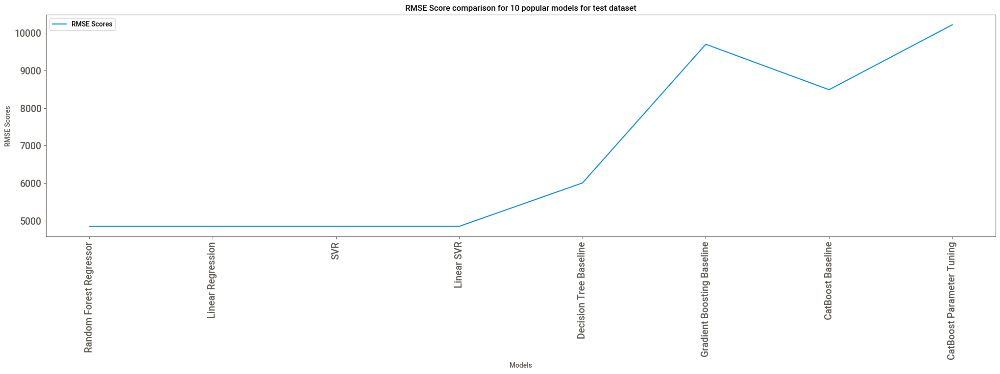

In [44]:
# Plot
plt.figure(figsize=[25,6])
plt.tick_params(labelsize=14)
plt.plot(accuracy_df.index, accuracy_df['rmse'], label = 'RMSE Scores')
plt.legend()
plt.title('RMSE Score comparison for 10 popular models for test dataset')
plt.xlabel('Models')
plt.ylabel('RMSE Scores')
plt.xticks(accuracy_df.index, rotation='vertical')
plt.savefig('graph.png')
plt.show()